Gobierno y Decisiones Públicas<br>
Profesor: **Dr. José Manuel Magallanes, PhD**



# Una mirada a la data del Mininter

<a target="_blank" href="https://colab.research.google.com/github/SocialAnalytics-StrategicIntelligence/pnpData/blob/main/DataPeru_PNP.ipynb">
  <img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
</a>


Data proveniente de [observatorio](https://observatorio.mininter.gob.pe/MapaDelDelitoGeorreferenciado) 

![](logoObservatorio.jpg)

## Qué se tiene?

In [1]:
import geopandas as gpd

PuntosMininter=gpd.read_file("https://github.com/SocialAnalytics-StrategicIntelligence/pnpData/raw/main/features10000.geojson")
PuntosMininter.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 24 columns):
 #   Column        Non-Null Count  Dtype   
---  ------        --------------  -----   
 0   direccion     10000 non-null  object  
 1   id_dpto       10000 non-null  object  
 2   departamento  10000 non-null  object  
 3   id_prov       10000 non-null  object  
 4   provincia     10000 non-null  object  
 5   id_dist       10000 non-null  object  
 6   distrito      10000 non-null  object  
 7   cod_cpnp      9999 non-null   object  
 8   comisaria     10000 non-null  object  
 9   id_materia    10000 non-null  int64   
 10  materia       10000 non-null  object  
 11  id_tipo       10000 non-null  int64   
 12  tipo          10000 non-null  object  
 13  id_subtipo    10000 non-null  int64   
 14  subtipo       10000 non-null  object  
 15  id_modalidad  10000 non-null  int64   
 16  modalidad     10000 non-null  object  
 17  anio_hecho    10000 non-null  int64   
 18 

## Qué grupos se quiere analizar?

- Periodo?
- Lugar?


In [2]:
# periodo
PuntosMininter.anio_hecho.value_counts()

anio_hecho
2018    9998
2020       1
2019       1
Name: count, dtype: int64

In [3]:
# provincias
PuntosMininter.provincia.value_counts()

provincia
LIMA        6190
CALLAO       753
AREQUIPA     611
PIURA        430
TRUJILLO     419
            ... 
PISCO          1
YAULI          1
JAEN           1
AYABACA        1
LORETO         1
Name: count, Length: 70, dtype: int64

La alternativa es **Lima 2018**:

In [4]:
delitosLima2018=PuntosMininter[(PuntosMininter.provincia=='LIMA') & (PuntosMininter.anio_hecho==2018)]

## Explorando Lima 2018

Reportes por comisaría:

In [5]:
import pandas as pd

pd.DataFrame(delitosLima2018.comisaria.value_counts()).reset_index(drop=False)

,comisaria,count
0,CPNP CANTO REY,363
1,CPNP VILLA EL SALVADOR,247
2,CPNP SOL DE ORO,244
3,CPNP LAURA CALLER IBERICO,218
4,CPNP VILLA MARIA DEL TRIUNFO,209
...,...,...
105,CPNP LA UNIFICADA,5
106,CPNP LAS PRADERAS,4
107,CPNP SAN BARTOLO,4
108,CPNP JICAMARCA,3


### dónde enfocarse?

In [6]:
delitosLima2018.comisaria.value_counts().describe()

count    110.000000
mean      56.254545
std       63.067524
min        1.000000
25%       17.000000
50%       35.000000
75%       66.000000
max      363.000000
Name: count, dtype: float64

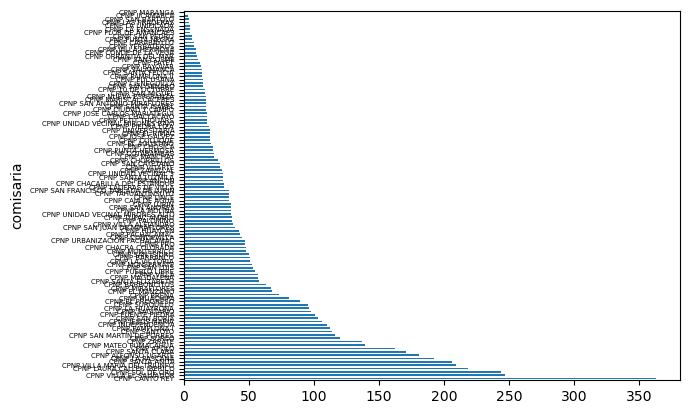

In [7]:
# valor de corte?

import matplotlib.pyplot as plt
ax=delitosLima2018.comisaria.value_counts().plot(kind='barh')
new_var = ax.tick_params(axis='y', labelsize=5)
new_var

Punto de corte: **mediana**

In [8]:
seleccionComisarias=delitosLima2018.comisaria.value_counts()[delitosLima2018.comisaria.value_counts()>=35].index
seleccionComisarias

Index(['CPNP CANTO REY', 'CPNP VILLA EL SALVADOR', 'CPNP SOL DE ORO',
       'CPNP LAURA CALLER IBERICO', 'CPNP VILLA MARIA DEL TRIUNFO',
       'CPNP SANTA ANITA', 'CPNP LA PASCANA', 'CPNP ALFONSO UGARTE',
       'CPNP SANTA CLARA', 'CPNP APOLO', 'CPNP MATEO PUMACAHUA', 'CPNP ZARATE',
       'CPNP SURCO', 'CPNP SAN MARTIN DE PORRES', 'CPNP SANTOYO',
       'CPNP PAMPLONA I', 'CPNP INDEPENDENCIA', 'CPNP JESUS MARIA',
       'CPNP SAN BORJA', 'CPNP PUENTE PIEDRA', 'CPNP SAGITARIO',
       'CPNP LA HUAYRONA', 'CPNP SURQUILLO', 'CPNP EL PROGRESO',
       'CPNP HUACHIPA', 'CPNP BREÑA', 'CPNP EL MANZANO', 'CPNP MIRAFLORES',
       'CPNP BARBONCITOS', 'CPNP SANTA ELIZABETH', 'CPNP MAGDALENA',
       'CPNP VILLA', 'CPNP PUEBLO LIBRE', 'CPNP SAN LUIS', 'CPNP MONSERRATE',
       'CPNP LA VICTORIA', 'CPNP BARRANCO', 'CPNP SAN ISIDRO',
       'CPNP MONTERRICO', 'CPNP CHACRA COLORADA', 'CPNP PRO',
       'CPNP URBANIZACION PACHACAMAC', 'CPNP CONDEVILLA', 'CPNP PACHACAMAC',
       'CPNP HUAYCAN', '

Enfocaremos:

In [9]:
DelitosLima2018_peores=delitosLima2018[delitosLima2018.comisaria.isin(seleccionComisarias)].copy().reset_index(drop=True)
DelitosLima2018_peores

,direccion,id_dpto,departamento,id_prov,provincia,id_dist,distrito,cod_cpnp,comisaria,id_materia,...,subtipo,id_modalidad,modalidad,anio_hecho,mes_hecho,dia_hecho,turno_hecho,time,estado,geometry
0,JR. PROGRESO MZ- 15 LT-03 ?PACHACAMAC,15,LIMA,1501,LIMA,150123,PACHACAMAC,2302,CPNP PACHACAMAC,1,...,DAÑOS,1051001,DAÑO SIMPLE,2018,1,1,tarde,"1/1/2018, 12:35 PM",1,POINT (-76.85853 -12.23112)
1,AV. REVOLUCION Y LA AV. 03 DE OCTUBRE,15,LIMA,1501,LIMA,150142,VILLA EL SALVADOR,2270,CPNP VILLA EL SALVADOR,1,...,PELIGRO COMUN,1120102,CONDUCCION EN ESTADO DE EBRIEDAD O DROGADICCION,2018,1,1,mañana,"1/1/2018, 6:40 AM",1,POINT (-76.93689 -12.21293)
2,AV. LOS ALAMOS CON AV. EL SOL SAN JUAN DE LURI...,15,LIMA,1501,LIMA,150132,SAN JUAN DE LURIGANCHO,2090,CPNP CANTO REY,1,...,PELIGRO COMUN,1120101,PELIGRO POR MEDIO DE INCENDIO O EXPLOSION,2018,1,1,madrugada,"1/1/2018, 5:10 AM",1,POINT (-76.99931 -11.98653)
3,av. dante cuadra 04,15,LIMA,1501,LIMA,150141,SURQUILLO,2190,CPNP SURQUILLO,1,...,LESIONES,1010311,LESIONES LEVES,2018,1,1,madrugada,"1/1/2018, 5:20 AM",1,POINT (-77.01211 -12.11003)
4,JIRON ARGENTINA Y JIRON COLOMBIA CHOSICA,15,LIMA,1501,LIMA,150118,LURIGANCHO,2170,CPNP HUACHIPA,1,...,PELIGRO COMUN,1120102,CONDUCCION EN ESTADO DE EBRIEDAD O DROGADICCION,2018,1,1,mañana,"1/1/2018, 8:00 AM",1,POINT (-76.91800 -12.00326)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5315,OVALO MIRAFLORES,15,LIMA,1501,LIMA,150122,MIRAFLORES,2215,CPNP MIRAFLORES,1,...,HURTO,1050101,HURTO,2018,1,21,noche,"1/21/2018, 7:30 PM",1,POINT (-77.02908 -12.11921)
5316,LAS GAVIOTAS MZ J2 LOTE 04 HUACHIPA,15,LIMA,1501,LIMA,150118,LURIGANCHO,2170,CPNP HUACHIPA,1,...,ROBO,1050215,ROBO AGRAVADO,2018,1,22,mañana,"1/22/2018, 11:30 AM",1,POINT (-76.95009 -12.01783)
5317,AV. HIPÓLITO UNANUE Y PROLONGACIÓN CANGALLO,15,LIMA,1501,LIMA,150115,LA VICTORIA,2030,CPNP LA VICTORIA,1,...,VIOLACION DE LA LIBERTAD PERSONAL,1040101,COACCION,2018,1,20,mañana,"1/20/2018, 10:00 AM",1,POINT (-77.02070 -12.06614)
5318,"Calle José Galvez 550, Miraflores 15074, Perú",15,LIMA,1501,LIMA,150122,MIRAFLORES,2215,CPNP MIRAFLORES,1,...,HURTO,1050107,HURTO AGRAVADO,2018,1,18,tarde,"1/18/2018, 4:00 PM",1,POINT (-77.03506 -12.12107)


### Mirada global espacial

In [10]:
#pip install mapclassify

In [11]:
DelitosLima2018_peores.explore()

Si se necesita los limites distritales:

<Axes: >

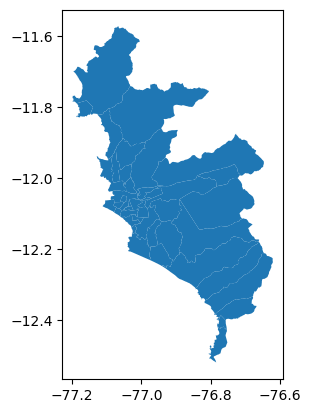

In [2]:
limitesLima=gpd.read_file("https://github.com/SocialAnalytics-StrategicIntelligence/pnpData/raw/main/LimaDelitos.gpkg", layer='poligonos')
limitesLima.plot()

Capa previa:

In [13]:
import folium

base=limitesLima.explore(name="Limites",color='grey',style_kwds={'fill':False})
m = DelitosLima2018_peores.explore(m=base, name="Points")
# this is completely optional
folium.LayerControl().add_to(m)

m

### Exploracion detallada: hora del delito

In [14]:
DelitosLima2018_peores.turno_hecho.value_counts()

turno_hecho
noche        1834
tarde        1332
mañana       1199
madrugada     955
Name: count, dtype: int64

<Axes: xlabel='turno_hecho'>

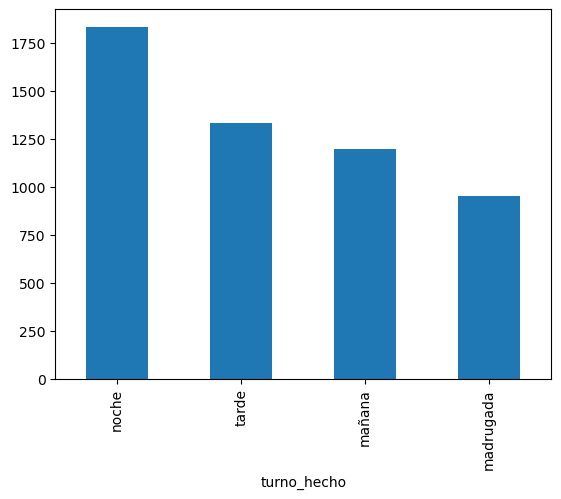

In [15]:
DelitosLima2018_peores.turno_hecho.value_counts().plot(kind='bar')

Cuando valores son similares, suele no verse patrones:

In [16]:
import folium

base=limitesLima.explore(name="Limites",color='grey',style_kwds={'fill':False},tiles='CartoDB positron')
m = DelitosLima2018_peores.explore(m=base, name="Points",
                                   column="turno_hecho",
                                   categorical=True,
                                   cmap=['blue','green','orange','black'])
folium.LayerControl().add_to(m)
m

Veamos tabla de doble entrada:

In [17]:
# columns suma 100%
pd.crosstab(DelitosLima2018_peores['distrito'],DelitosLima2018_peores['turno_hecho'],normalize='columns',margins=True)*100

turno_hecho,madrugada,mañana,noche,tarde,All
distrito,,,,,
ATE,4.816754,3.586322,3.598691,4.354354,4.003759
BARRANCO,1.675393,0.750626,0.654308,1.051051,0.958647
BREÑA,1.256545,1.834862,2.290076,3.003003,2.180451
CARABAYLLO,2.094241,1.584654,1.308615,1.951952,1.672932
CHORRILLOS,3.036649,3.669725,3.162486,4.654655,3.627820
COMAS,5.549738,4.587156,4.362050,3.078078,4.304511
EL AGUSTINO,2.617801,2.085071,2.181025,1.951952,2.180451
INDEPENDENCIA,3.036649,2.251877,3.707743,1.576577,2.725564
JESUS MARIA,0.837696,1.751460,2.290076,2.552553,1.973684


Hay valor **atípico**:

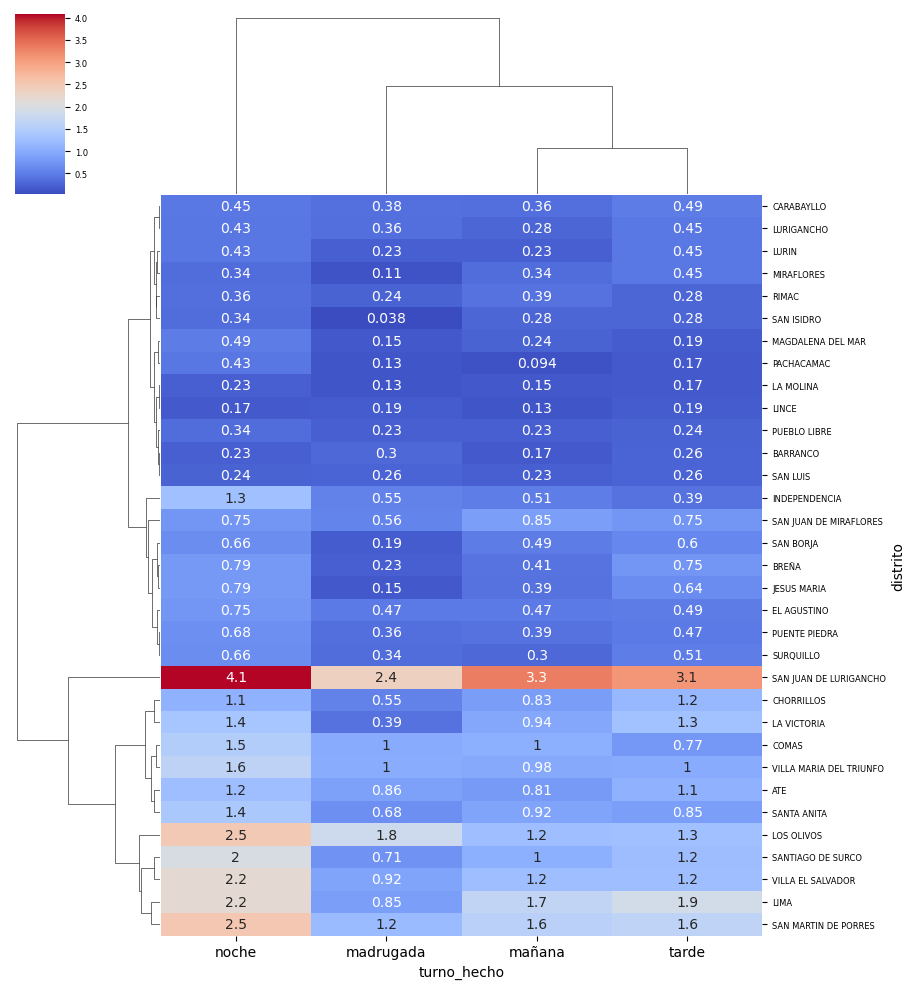

In [18]:
# normalize all

import seaborn as sns

delitos_margins=pd.crosstab(DelitosLima2018_peores['distrito'],DelitosLima2018_peores['turno_hecho'],normalize='all',margins=False)*100

ax=sns.clustermap(delitos_margins,method='ward', cmap='coolwarm', yticklabels=True,annot=True)
ax.tick_params(axis='y', labelsize=6)

- Saquemos al atípico. 

- Qué deseamos?: **agrupar distritos**
  
- Como es el delito en el distrito a lo largo del dia?
     a.  Según los conteos del ditrito


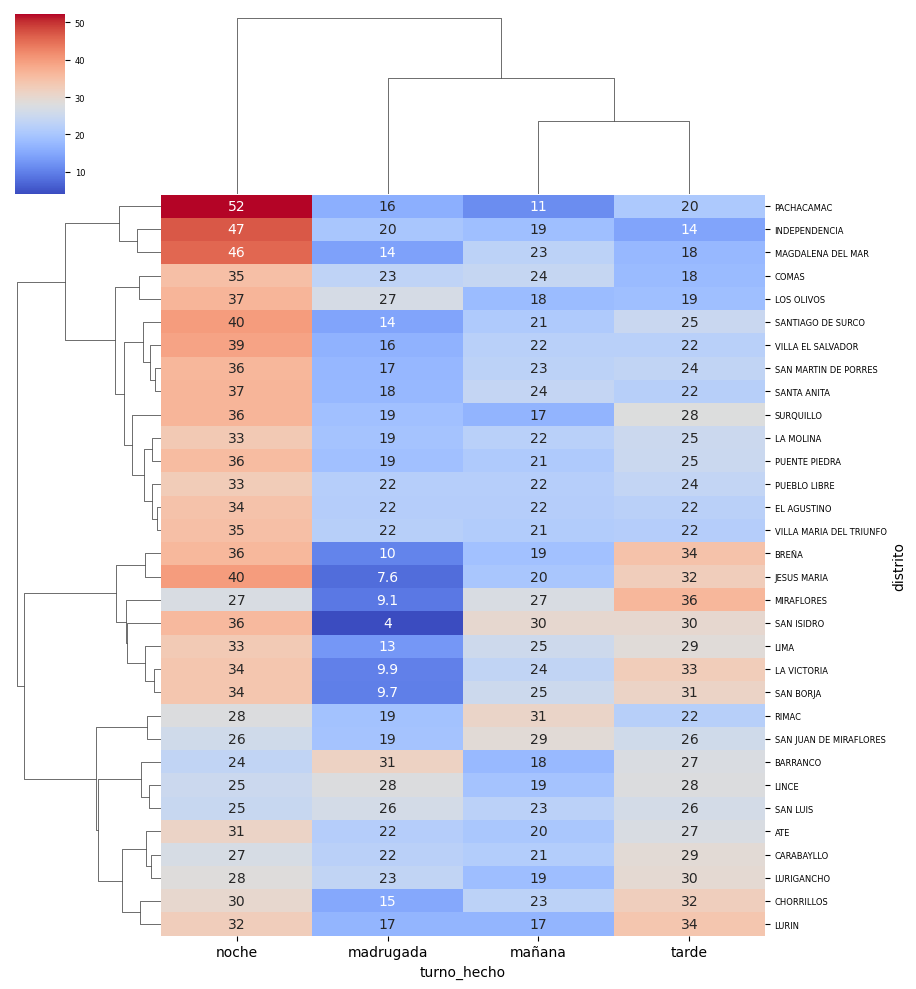

In [19]:
DelitosLima2018_peores_sinSJL=DelitosLima2018_peores[DelitosLima2018_peores['distrito']!='SAN JUAN DE LURIGANCHO']


delitos_margins=pd.crosstab(DelitosLima2018_peores_sinSJL['distrito'],DelitosLima2018_peores_sinSJL['turno_hecho'],normalize='index')*100
ax=sns.clustermap(delitos_margins, method='ward',cmap='coolwarm', yticklabels=True,annot=True)
ax.tick_params(axis='y', labelsize=6)

     b.  Según los conteos de en el turno del día

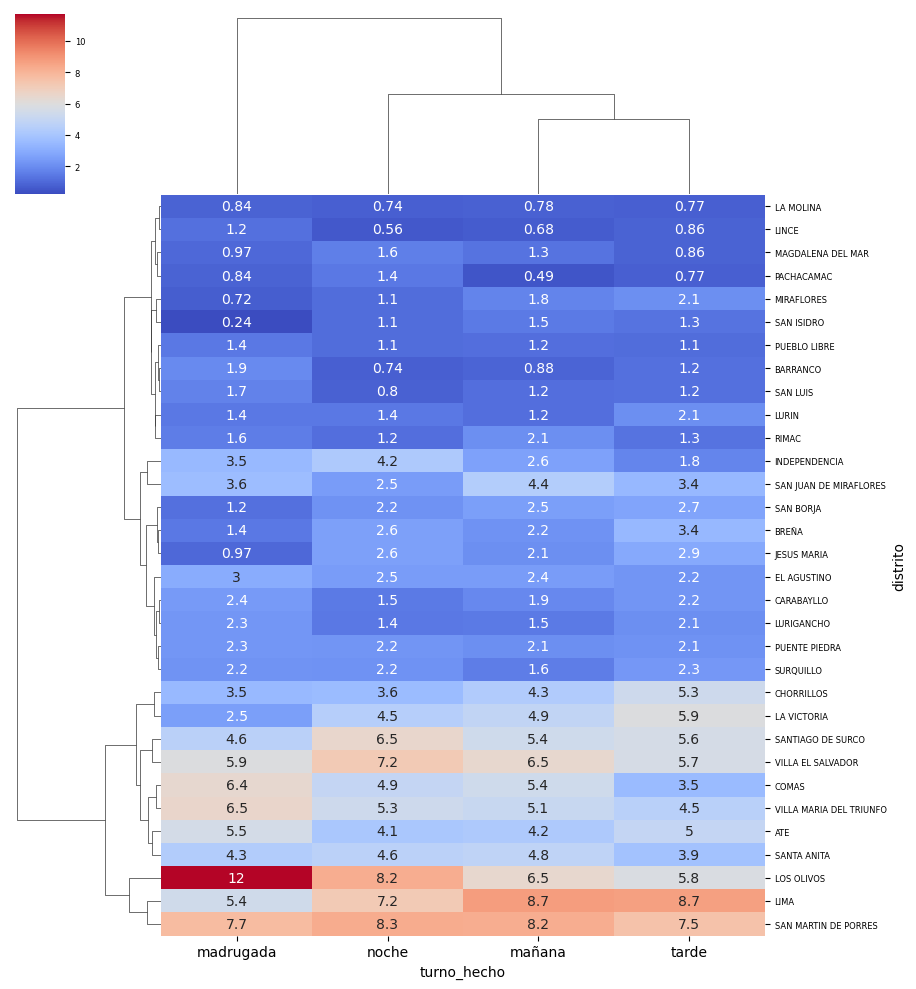

In [20]:
delitos_margins=pd.crosstab(DelitosLima2018_peores_sinSJL['distrito'],DelitosLima2018_peores_sinSJL['turno_hecho'],normalize='columns')*100

ax=sns.clustermap(delitos_margins, method='ward', cmap='coolwarm', yticklabels=True,annot=True)
ax.tick_params(axis='y', labelsize=6)

### Exploración detallada: tipo de delito

Afecta el atípico?

In [21]:
DelitosLima2018_peores.subtipo.value_counts().head(10)

subtipo
HURTO                                2357
ROBO                                 1793
LESIONES                              355
PELIGRO COMUN                         290
VIOLACION DE LA LIBERTAD SEXUAL       153
ESTAFA Y OTRAS DEFRAUDACIONES          89
SALUD PUBLICA                          38
COMETIDOS POR PARTICULARES             36
USURPACION                             32
VIOLACION DE LA LIBERTAD PERSONAL      23
Name: count, dtype: int64

In [22]:
DelitosLima2018_peores_sinSJL.subtipo.value_counts().head(10)

subtipo
HURTO                              2084
ROBO                               1518
LESIONES                            319
PELIGRO COMUN                       253
VIOLACION DE LA LIBERTAD SEXUAL     139
ESTAFA Y OTRAS DEFRAUDACIONES        80
SALUD PUBLICA                        34
COMETIDOS POR PARTICULARES           29
USURPACION                           24
DAÑOS                                19
Name: count, dtype: int64

In [23]:
tiposParaAnalisis=DelitosLima2018_peores_sinSJL.subtipo.value_counts().head(5).index
tiposParaAnalisis

Index(['HURTO', 'ROBO', 'LESIONES', 'PELIGRO COMUN',
       'VIOLACION DE LA LIBERTAD SEXUAL'],
      dtype='object', name='subtipo')

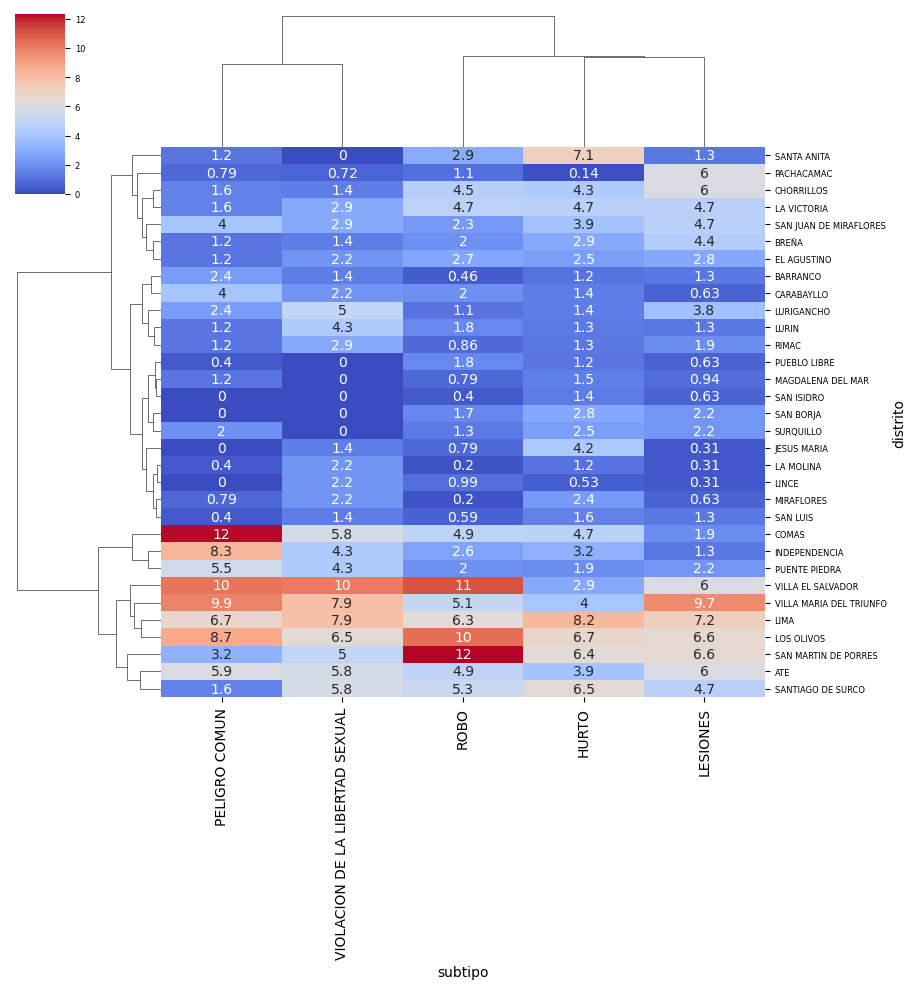

In [24]:
DelitosLima2018_peoresTipos=DelitosLima2018_peores_sinSJL[DelitosLima2018_peores_sinSJL.subtipo.isin(tiposParaAnalisis)]

delitosTipos_margins=pd.crosstab(DelitosLima2018_peoresTipos['distrito'],DelitosLima2018_peoresTipos['subtipo'],normalize='columns')*100

ax=sns.clustermap(delitosTipos_margins, method='ward',cmap='coolwarm', yticklabels=True,annot=True)
ax.tick_params(axis='y', labelsize=6)

In [25]:
centroidLima=DelitosLima2018_peoresTipos.dissolve().centroid

/var/folders/2n/bkfhfqq16r78g3hf7pdj56y40000gn/T/ipykernel_19423/53041390.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroidLima=DelitosLima2018_peoresTipos.dissolve().centroid


In [26]:
import folium

from folium import plugins

y=centroidLima.y[0]
x=centroidLima.x[0]

map = folium.Map(location=[y, x], tiles="CartoDB positron", zoom_start=10)

#qué delito?
Cuales=DelitosLima2018_peoresTipos[DelitosLima2018_peoresTipos.subtipo.isin(['HURTO','ROBO'])]

heat_data = [[point.xy[1][0], point.xy[0][0]] for point in Cuales.geometry]


plugins.HeatMap(heat_data).add_to(map)

map

In [27]:
map = folium.Map(location=[y, x], tiles="CartoDB positron", zoom_start=10)

#qué delito?
Cuales=DelitosLima2018_peoresTipos[DelitosLima2018_peoresTipos.subtipo.isin(['VIOLACION DE LA LIBERTAD SEXUAL'])]

heat_data = [[point.xy[1][0], point.xy[0][0]] for point in Cuales.geometry]


plugins.HeatMap(heat_data).add_to(map)

map

In [28]:

m = folium.Map(location=[y, x], tiles="CartoDB positron", zoom_start=10)

plugins.MarkerCluster(heat_data).add_to(m)


m

In [29]:
# limitesLima.to_file("LimaDelitos.gpkg", layer='poligonos', driver="GPKG")
# delitosLima2018.to_file("LimaDelitos.gpkg", layer='puntos2018', driver="GPKG")

# import fiona
# gpkg = 'LimaDelitos.gpkg'
# layers = fiona.listlayers('LimaDelitos.gpkg')
# layers